# Part 2

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
file = pd.read_csv('~/Desktop/DataAnalysis/Workshop2/cleaned_Amazon_data.csv')


In [3]:
file.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,04-30-22,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,04-30-22,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,04-30-22,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,04-30-22,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,04-30-22,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown


In [4]:
file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118114 entries, 0 to 118113
Data columns (total 18 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Order ID            118114 non-null  object 
 1   Date                118114 non-null  object 
 2   Status              118114 non-null  object 
 3   Fulfilment          118114 non-null  object 
 4   Sales Channel       118114 non-null  object 
 5   ship-service-level  118114 non-null  object 
 6   Category            118114 non-null  object 
 7   Size                118114 non-null  object 
 8   Courier Status      118114 non-null  object 
 9   Qty                 118114 non-null  int64  
 10  currency            118114 non-null  object 
 11  Amount              118114 non-null  float64
 12  ship-city           118114 non-null  object 
 13  ship-state          118114 non-null  object 
 14  ship-postal-code    118114 non-null  object 
 15  ship-country        118114 non-nul

In [5]:
file.shape

(118114, 18)

In [6]:
from datetime import datetime as dt

In [7]:
def convertToDate(x):
    return dt.strptime(x, '%m-%d-%y')

In [8]:
pattern = r'^\d{2}-\d{2}-\d{2}$'

In [9]:
file[file['Date'].str.contains(pattern, regex=True)]

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,04-30-22,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,04-30-22,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,04-30-22,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,04-30-22,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,04-30-22,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118109,406-6001380-7673107,05-31-22,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,517.00,HYDERABAD,TELANGANA,500013.0,IN,False,unknown
118110,402-9551604-7544318,05-31-22,Shipped,Amazon,Amazon.in,Expedited,T-shirt,M,Shipped,1,INR,999.00,GURUGRAM,HARYANA,122004.0,IN,False,unknown
118111,407-9547469-3152358,05-31-22,Shipped,Amazon,Amazon.in,Expedited,Blazzer,XXL,Shipped,1,INR,690.00,HYDERABAD,TELANGANA,500049.0,IN,False,unknown
118112,402-6184140-0545956,05-31-22,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XS,Shipped,1,INR,1199.00,Halol,Gujarat,389350.0,IN,False,unknown


In [10]:
file[~file['Date'].str.contains(pattern, regex=True)]

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
27270,405-6163095-9509124,04-12-2022,Shipped,Amazon,Amazon.in,Expedited,Trousers,XS,Shipped,1,INR,531.0,AHMEDABAD,Gujarat,382440.0,IN,False,unknown
27271,403-2229855-3541155,04-12-2022,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,329.0,Mumbai,MAHARASHTRA,400067.0,IN,False,unknown
27272,171-1029312-3038738,04-12-2022,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Blazzer,M,Shipped,1,INR,859.0,GURUGRAM,HARYANA,122003.0,IN,False,Easy Ship
27273,408-5086595-1206718,04-12-2022,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,L,Shipped,1,INR,725.0,FCI TOWNSHIP,ODISHA,759116.0,IN,False,Easy Ship
27274,405-2183842-2225946,04-12-2022,Shipped,Amazon,Amazon.in,Expedited,T-shirt,M,Shipped,1,INR,1186.0,HYDERABAD,TELANGANA,500055.0,IN,False,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118025,171-0210562-5575545,06-01-2022,Shipped,Amazon,Amazon.in,Expedited,T-shirt,L,Shipped,1,INR,889.0,Chandigarh,CHANDIGARH,160018.0,IN,False,unknown
118026,405-1423498-9705162,06-01-2022,Shipped,Amazon,Amazon.in,Expedited,Shirt,M,Shipped,1,INR,399.0,COIMBATORE,TAMIL NADU,641017.0,IN,False,unknown
118027,403-6638920-0842712,06-01-2022,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XXL,Shipped,1,INR,771.0,HYDERABAD,TELANGANA,500015.0,IN,False,unknown
118028,408-4694875-8249153,06-01-2022,Shipped,Amazon,Amazon.in,Expedited,Blazzer,XL,Shipped,1,INR,885.0,Pune,MAHARASHTRA,411038.0,IN,False,unknown


In [11]:
def stripString(x):
    if len(x.split('-')[-1]) == 4:
        return  x[0:6] + x[8:]
    else:
        return x

In [12]:
file['Date'] = file['Date'].apply(stripString)

In [13]:
# pattern = r'^\d{2}-\d{2}-\d{2}$'
file[~file['Date'].str.contains(pattern, regex=True)]

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by


In [14]:
file['Date'] = file['Date'].apply(convertToDate)

In [15]:
file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118114 entries, 0 to 118113
Data columns (total 18 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Order ID            118114 non-null  object        
 1   Date                118114 non-null  datetime64[ns]
 2   Status              118114 non-null  object        
 3   Fulfilment          118114 non-null  object        
 4   Sales Channel       118114 non-null  object        
 5   ship-service-level  118114 non-null  object        
 6   Category            118114 non-null  object        
 7   Size                118114 non-null  object        
 8   Courier Status      118114 non-null  object        
 9   Qty                 118114 non-null  int64         
 10  currency            118114 non-null  object        
 11  Amount              118114 non-null  float64       
 12  ship-city           118114 non-null  object        
 13  ship-state          118114 no

In [16]:
file.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,2022-04-30,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown


In [17]:
file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118114 entries, 0 to 118113
Data columns (total 18 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Order ID            118114 non-null  object        
 1   Date                118114 non-null  datetime64[ns]
 2   Status              118114 non-null  object        
 3   Fulfilment          118114 non-null  object        
 4   Sales Channel       118114 non-null  object        
 5   ship-service-level  118114 non-null  object        
 6   Category            118114 non-null  object        
 7   Size                118114 non-null  object        
 8   Courier Status      118114 non-null  object        
 9   Qty                 118114 non-null  int64         
 10  currency            118114 non-null  object        
 11  Amount              118114 non-null  float64       
 12  ship-city           118114 non-null  object        
 13  ship-state          118114 no

In [18]:
file.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,2022-04-30,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown


In [19]:
file.describe()

,Qty,Amount
count,118114.000000,118114.000000
mean,0.960479,661.901247
std,0.216408,268.798742
min,0.000000,199.000000
25%,1.000000,459.000000
50%,1.000000,625.000000
75%,1.000000,788.000000
max,8.000000,5584.000000


In [20]:
file[file['Qty'] == 0]

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
3,403-9615377-8133951,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
22,404-6019946-2909948,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,M,On the Way,0,INR,570.48,pune,MAHARASHTRA,411044.0,IN,False,Easy Ship
80,404-6522553-9345930,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,M,On the Way,0,INR,1105.36,DEHRADUN,UTTARAKHAND,248001.0,IN,False,Easy Ship
167,171-1224053-5752314,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Trousers,L,On the Way,0,INR,463.81,BENGALURU,KARNATAKA,560087.0,IN,False,Easy Ship
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117888,403-2139190-8481165,2022-06-01,Cancelled,Merchant,Amazon.in,Standard,Blazzer,XL,On the Way,0,INR,700.00,Barabanki,UTTAR PRADESH,225001.0,IN,False,Easy Ship
117918,402-4651401-6366769,2022-06-01,Cancelled,Merchant,Amazon.in,Standard,Trousers,S,On the Way,0,INR,519.05,BENGALURU,KARNATAKA,560043.0,IN,False,Easy Ship
117919,402-4651401-6366769,2022-06-01,Cancelled,Merchant,Amazon.in,Standard,Shirt,S,On the Way,0,INR,385.71,BENGALURU,KARNATAKA,560043.0,IN,False,Easy Ship
118022,403-9524128-9243508,2022-06-01,Cancelled,Merchant,Amazon.in,Standard,Blazzer,XL,On the Way,0,INR,734.29,Barabanki,UTTAR PRADESH,225001.0,IN,False,Easy Ship


In [21]:
file['Status'].value_counts()

Shipped                          75688
Shipped - Delivered to Buyer     27794
Cancelled                        10703
Shipped - Returned to Seller      1891
Shipped - Picked Up                942
Pending                            637
Pending - Waiting for Pick Up      268
Shipped - Returning to Seller      142
Shipped - Out for Delivery          35
Shipped - Rejected by Buyer         11
Shipped - Lost in Transit            2
Shipped - Damaged                    1
Name: Status, dtype: int64

In [22]:
sortedByDate = file.sort_values('Date')
sortedByDate.reset_index(drop=True, inplace=True)
sortedByDate.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,404-5350794-8541144,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,481.00,KOLKATA,WEST BENGAL,700124.0,IN,False,unknown
1,171-3572716-7638764,2022-03-31,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,XXL,Shipped,1,INR,248.00,NADUVANNUR,KERALA,673614.0,IN,False,Easy Ship
2,402-7244631-8305928,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,XXL,Shipped,1,INR,322.00,CHENNAI,TAMIL NADU,600042.0,IN,False,unknown
3,406-7387241-2881923,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XL,Shipped,1,INR,599.00,BENGALURU,KARNATAKA,560090.0,IN,False,unknown
4,402-9332104-0945115,2022-03-31,Cancelled,Merchant,Amazon.in,Standard,Shirt,M,On the Way,0,INR,416.19,GURGAON,HARYANA,122001.0,IN,False,Easy Ship


In [23]:
sortedByDate['Date'].min(), sortedByDate['Date'].max()

(Timestamp('2022-03-31 00:00:00'), Timestamp('2022-06-29 00:00:00'))

3 month sale

2022-03 sales records

In [24]:
march2022 = sortedByDate[(sortedByDate['Date'].dt.year == 2022) & (sortedByDate['Date'].dt.month == 3)]
march2022

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,404-5350794-8541144,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,481.00,KOLKATA,WEST BENGAL,700124.0,IN,False,unknown
1,171-3572716-7638764,2022-03-31,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,XXL,Shipped,1,INR,248.00,NADUVANNUR,KERALA,673614.0,IN,False,Easy Ship
2,402-7244631-8305928,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,XXL,Shipped,1,INR,322.00,CHENNAI,TAMIL NADU,600042.0,IN,False,unknown
3,406-7387241-2881923,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XL,Shipped,1,INR,599.00,BENGALURU,KARNATAKA,560090.0,IN,False,unknown
4,402-9332104-0945115,2022-03-31,Cancelled,Merchant,Amazon.in,Standard,Shirt,M,On the Way,0,INR,416.19,GURGAON,HARYANA,122001.0,IN,False,Easy Ship
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,405-1344496-4624333,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XXL,Shipped,1,INR,542.00,margao,GOA,403601.0,IN,False,unknown
158,171-7326790-9044369,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,353.00,ARANI TIRUVANNAMALAI DISTRICT,TAMIL NADU,632317.0,IN,False,unknown
159,403-5713213-8502730,2022-03-31,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,M,Shipped,1,INR,379.00,KOLKATA,WEST BENGAL,700034.0,IN,False,Easy Ship
160,171-7326790-9044369,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,453.00,ARANI TIRUVANNAMALAI DISTRICT,TAMIL NADU,632317.0,IN,False,unknown


In [25]:
sortedByDate['Date'].value_counts().sort_index()

2022-03-31     162
2022-04-01    1328
2022-04-02    1422
2022-04-03    1554
2022-04-04    1347
              ... 
2022-06-25     938
2022-06-26    1132
2022-06-27    1016
2022-06-28    1093
2022-06-29     614
Name: Date, Length: 91, dtype: int64

In [26]:
grouped_by_month = sortedByDate.groupby(sortedByDate['Date'].apply(lambda x: x.month)).sum(numeric_only=True)
grouped = sortedByDate.groupby(pd.Grouper(key='Date', freq='M')).sum(numeric_only=True)

In [27]:
grouped_by_month

,Qty,Amount,B2B
Date,,,
3,156,101683.85,0
4,42922,28627458.79,334
5,37022,26105818.34,271
6,33346,23344842.90,234


In [28]:
# def cdate(x):
#     x = x.strftime('%Y-%m')
#     return x

In [29]:
# grouped_by_month
# grouped.index = grouped.index.map(cdate)
# grouped.index = pd.to_datetime(grouped.index)

In [30]:
grouped

,Qty,Amount,B2B
Date,,,
2022-03-31,156,101683.85,0
2022-04-30,42922,28627458.79,334
2022-05-31,37022,26105818.34,271
2022-06-30,33346,23344842.90,234


In [31]:
def splitComma(x):
    x = f"{x:.2f}"
    x = (str)(x)
    a = x.split('.')
    b = a[0]
    c = ''
    for i in range(len(b)):
        if i%3 == 0 and i != len(b)-1:
            c =  c + b[i] + ','
        else:
            c =  c + b[i]
    return (c + '.' + a[1])

In [32]:
grouped['strAmount'] = grouped['Amount'].apply(splitComma)
grouped

,Qty,Amount,B2B,strAmount
Date,,,,
2022-03-31,156,101683.85,0,"1,016,83.85"
2022-04-30,42922,28627458.79,334,"2,862,745,8.79"
2022-05-31,37022,26105818.34,271,"2,610,581,8.34"
2022-06-30,33346,23344842.90,234,"2,334,484,2.90"


In [33]:

# Format the index to show month names
# month_names = grouped.index.strftime('%B')

# plt.figure(figsize=(10, 5))
# plt.plot(grouped.index, grouped['Amount'], marker='o')
# plt.xticks(grouped.index, month_names)  # Show month names on the x-axis
# plt.xlabel('Date', color='brown')
# plt.ylabel('Amount', color='brown')
# plt.title('Monthly Sales Amount\n\n', color='brown')
# plt.grid()
# plt.show()

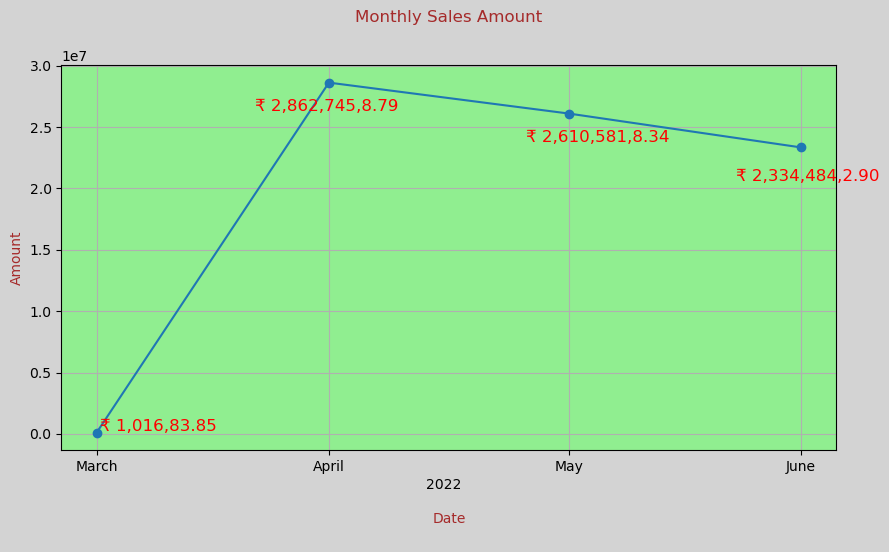

Text(0.5, 72.59999999999998, '\n\nDate\n')


In [34]:
month_names = grouped.index.strftime('%B')
plt.figure(figsize=(10, 5), facecolor='lightgrey')
plt.title('Monthly Sales Amount\n\n', color='brown')
ax = plt.gca()  # Get the current axis
ax.set_facecolor('lightgreen')
plt.plot(grouped.index, grouped['Amount'], marker='o')
plt.xticks(grouped.index, month_names)  # Ensure all indices are shown on the x-axis
plt.xlabel('\n\nDate\n', color='brown')
plt.ylabel('Amount', color='brown')
plt.grid()
x = [0.05, 0.25, 0.6, 0.87]
y = [0.05,0.88, 0.8, 0.7]
for i in range(4):
    ax.text(x[i], y[i], f"\u20B9 {grouped['strAmount'].iloc[i]}", fontsize=12, color='red', transform=ax.transAxes)
plt.text(0.47, -0.1, f'{grouped.index[0].year}', transform=ax.transAxes)
plt.show()
print(ax.xaxis.get_label())

<Axes: xlabel='Date'>

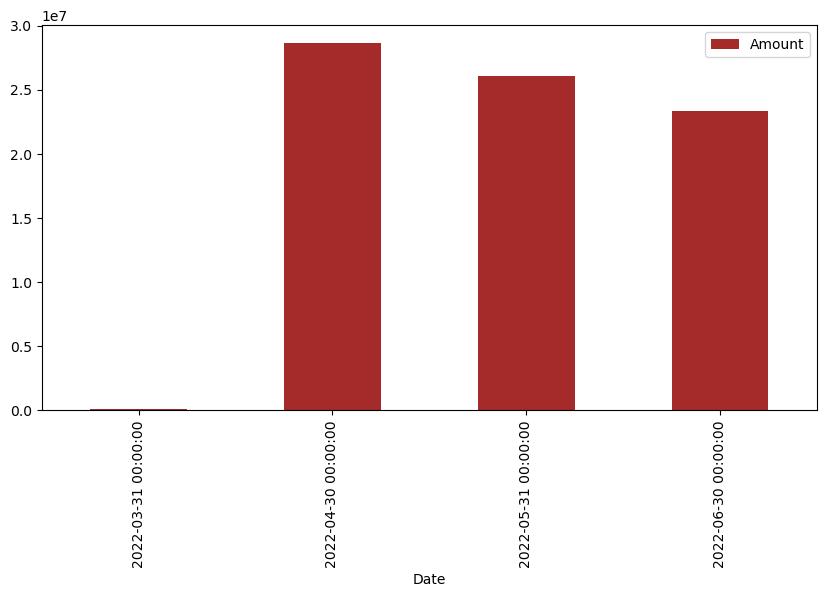

In [35]:
grouped.plot(kind='bar', y='Amount', color='brown', figsize=(10, 5))

In [36]:
# ax = grouped.plot(kind='line', y='Amount'\
#     ,marker='o', figsize=(10,5), color='blue')
# ax.set_title("Monthly Sales\n\n", fontsize=15, color='brown')
# print(ax.title.get_position())
# ax.set_facecolor('lightblue')
# ax.grid(color='white')
# ax.set_xlabel('Month', fontsize=12, color='brown')
# ax.set_ylabel('Amount', fontsize=12, color='brown')
# x = [0.05, 0.25, 0.6, 0.9]
# y = [0.05,0.88, 0.8, 0.7]
# for i in range(4):
#     ax.text(x[i], y[i], f"\u20B9 {grouped['strAmount'].iloc[i]}", fontsize=12, color='red', transform=ax.transAxes)

In [37]:
file.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,2022-04-30,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown


In [38]:
catagory_wise_sales = sortedByDate.groupby('Category')[['Qty','Amount']].sum().sort_values('Qty', ascending=False)
catagory_wise_sales['SAmount'] = catagory_wise_sales['Amount'].apply(splitComma)
catagory_wise_sales

,Qty,Amount,SAmount
Category,,,
T-shirt,44053,39074570.36,"3,907,457,0.36"
Shirt,43740,21127971.29,"2,112,797,1.29"
Blazzer,13615,11141538.83,"1,114,153,8.83"
Trousers,9689,5328406.30,"5,328,406.30"
Perfume,1016,787818.66,"7,878,18.66"
Wallet,810,452367.18,"4,523,67.18"
Socks,377,147552.50,"1,475,52.50"
Shoes,144,118968.76,"1,189,68.76"
Watch,2,610.00,"6,10.00"


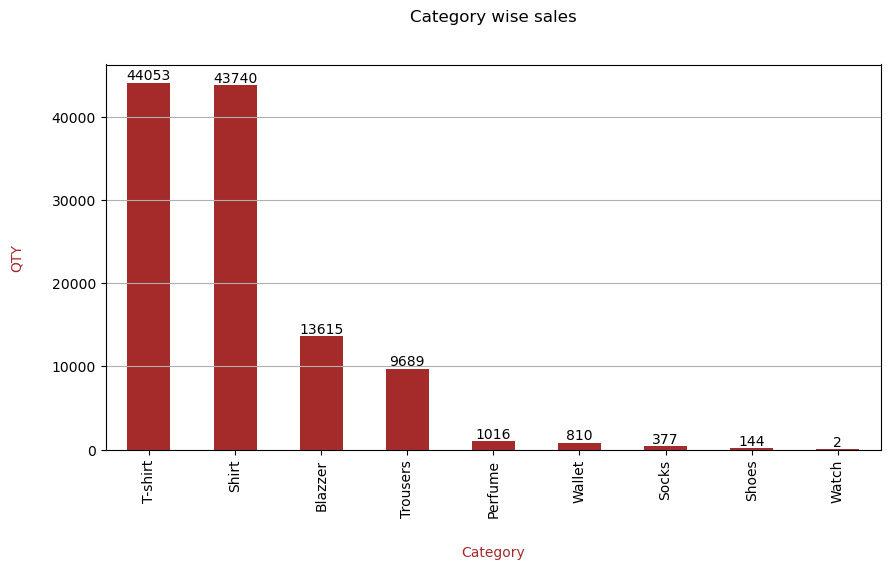

In [39]:
ax = catagory_wise_sales['Qty'].plot(kind='bar',\
    title='Category wise sales\n\n', figsize=(10,5), color='brown')
ax.set_ylabel('QTY', color='brown', labelpad=20)
ax.set_xlabel('Category', color='brown', labelpad=20)
# for i in grouped.shape[0]:
# print(ax.patches)  # paches show the position of the bar, center of the bar are 0,1,2...
for i in ax.patches:
    ax.text(i.get_x() + i.get_width()/2, i.get_height(), i.get_height(), ha='center', va='bottom')
ax.grid(axis='y')


In [40]:
catagory_wise_sales

,Qty,Amount,SAmount
Category,,,
T-shirt,44053,39074570.36,"3,907,457,0.36"
Shirt,43740,21127971.29,"2,112,797,1.29"
Blazzer,13615,11141538.83,"1,114,153,8.83"
Trousers,9689,5328406.30,"5,328,406.30"
Perfume,1016,787818.66,"7,878,18.66"
Wallet,810,452367.18,"4,523,67.18"
Socks,377,147552.50,"1,475,52.50"
Shoes,144,118968.76,"1,189,68.76"
Watch,2,610.00,"6,10.00"


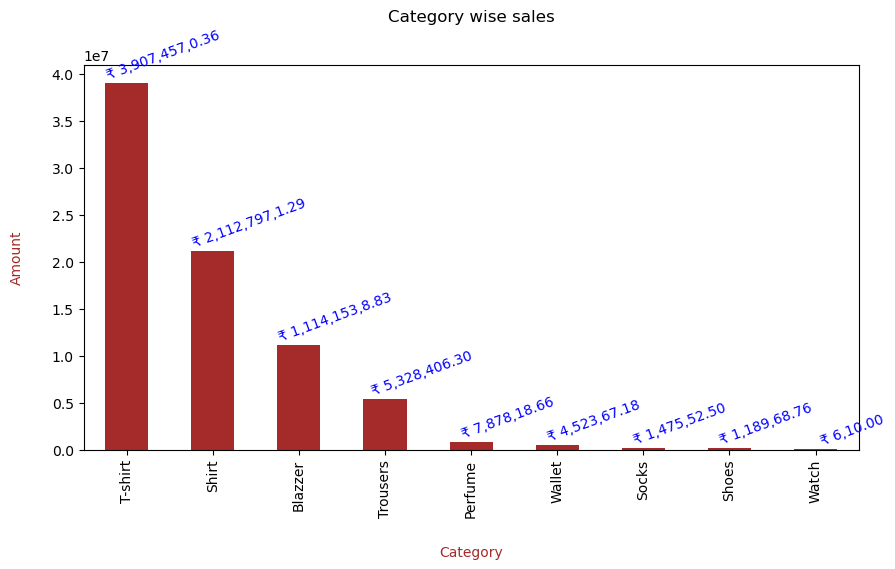

In [41]:
ax = catagory_wise_sales['Amount'].plot(kind='bar',\
    title='Category wise sales\n\n', figsize=(10,5), color='brown')
ax.set_ylabel('Amount', color='brown', labelpad=20)
ax.set_xlabel('Category', color='brown', labelpad=20)
# ax.set_yticks(catagory_wise_sales['Amount'])
# for i in grouped.shape[0]:
# print(ax.patches)  # paches show the position of the bar, center of the bar are 0,1,2...
for i,j in zip(ax.patches, range(catagory_wise_sales.shape[0])):
    ax.text((i.get_x() + i.get_width()/2)+0.40, i.get_height(), " \u20B9 " + catagory_wise_sales['SAmount'].iloc[j], \
        ha='center', va='bottom', rotation=20, color='blue')
# ax.grid(axis='y')

In [42]:
catagory_wise_sales

,Qty,Amount,SAmount
Category,,,
T-shirt,44053,39074570.36,"3,907,457,0.36"
Shirt,43740,21127971.29,"2,112,797,1.29"
Blazzer,13615,11141538.83,"1,114,153,8.83"
Trousers,9689,5328406.30,"5,328,406.30"
Perfume,1016,787818.66,"7,878,18.66"
Wallet,810,452367.18,"4,523,67.18"
Socks,377,147552.50,"1,475,52.50"
Shoes,144,118968.76,"1,189,68.76"
Watch,2,610.00,"6,10.00"


<Axes: title={'center': 'Category wise sales'}, ylabel='No. of Sales'>

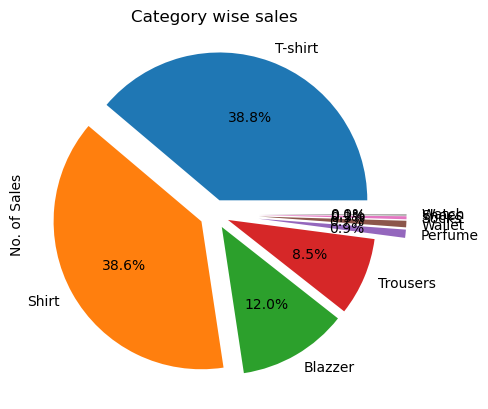

In [43]:
catagory_wise_sales['Qty'].plot(kind='pie', title='Category wise sales', ylabel='No. of Sales', explode=[0.1,0.1,0.1,0.1,0.3,0.3,0.3,0.3,0.3], autopct='%1.1f%%')

In [44]:
sortedByDate.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,404-5350794-8541144,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,481.00,KOLKATA,WEST BENGAL,700124.0,IN,False,unknown
1,171-3572716-7638764,2022-03-31,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,XXL,Shipped,1,INR,248.00,NADUVANNUR,KERALA,673614.0,IN,False,Easy Ship
2,402-7244631-8305928,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,XXL,Shipped,1,INR,322.00,CHENNAI,TAMIL NADU,600042.0,IN,False,unknown
3,406-7387241-2881923,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XL,Shipped,1,INR,599.00,BENGALURU,KARNATAKA,560090.0,IN,False,unknown
4,402-9332104-0945115,2022-03-31,Cancelled,Merchant,Amazon.in,Standard,Shirt,M,On the Way,0,INR,416.19,GURGAON,HARYANA,122001.0,IN,False,Easy Ship


In [45]:
grouped_result = sortedByDate.groupby(['Category', 'Size'])['Qty'].sum()
filtered_result = grouped_result.loc[['Shirt', 'T-shirt', 'Trousers', 'Blazzer']]
filtered_result = filtered_result.unstack().astype('Int64')
filtered_result


Size,3XL,4XL,5XL,6XL,L,M,S,XL,XS,XXL
Category,,,,,,,,,,
Shirt,5020,343,449,603,7785,7457,5018,7602,2726,6737
T-shirt,5152,43,56,69,7175,8162,6516,6658,4812,5410
Trousers,1098,<NA>,<NA>,<NA>,1600,1661,1127,1696,849,1658
Blazzer,1730,<NA>,<NA>,<NA>,2469,2269,1913,2074,1253,1907


In [46]:
grouped_result.unstack()

Size,3XL,4XL,5XL,6XL,Free,L,M,S,XL,XS,XXL
Category,,,,,,,,,,,
Blazzer,1730.0,NaN,NaN,NaN,NaN,2469.0,2269.0,1913.0,2074.0,1253.0,1907.0
Perfume,NaN,NaN,NaN,NaN,1016.0,NaN,NaN,NaN,NaN,NaN,NaN
Shirt,5020.0,343.0,449.0,603.0,NaN,7785.0,7457.0,5018.0,7602.0,2726.0,6737.0
Shoes,NaN,NaN,NaN,NaN,144.0,NaN,NaN,NaN,NaN,NaN,NaN
Socks,58.0,NaN,NaN,NaN,NaN,61.0,47.0,64.0,60.0,25.0,62.0
T-shirt,5152.0,43.0,56.0,69.0,NaN,7175.0,8162.0,6516.0,6658.0,4812.0,5410.0
Trousers,1098.0,NaN,NaN,NaN,NaN,1600.0,1661.0,1127.0,1696.0,849.0,1658.0
Wallet,NaN,NaN,NaN,NaN,810.0,NaN,NaN,NaN,NaN,NaN,NaN
Watch,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN


Rectangle(xy=(0, -0.25), width=5152, height=0.5, angle=0)


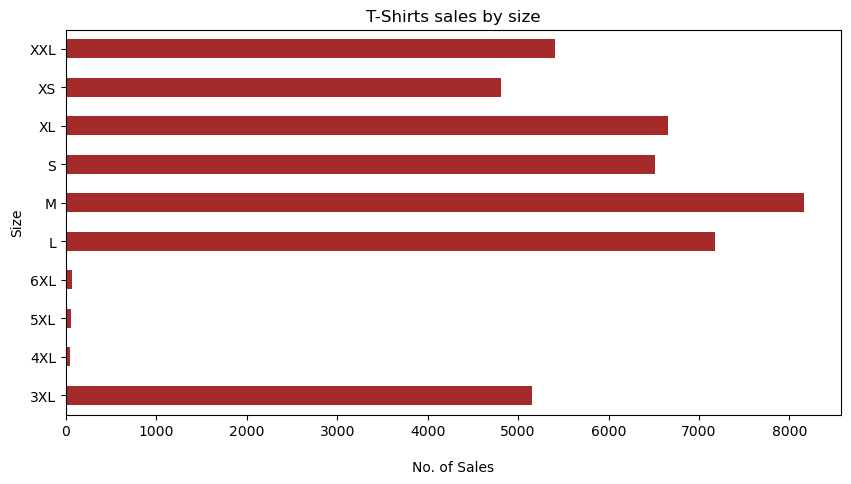

In [47]:
# filtered_result.loc['Trousers',:].max()
# filtered_result.loc['Trousers',:].idxmax()
ax = filtered_result.loc['T-shirt',:].plot(kind='barh', title='T-Shirts sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', figsize=(10,5))
ax.plot()
print(ax.patches[0])

Rectangle(xy=(0, -0.25), width=5020, height=0.5, angle=0)


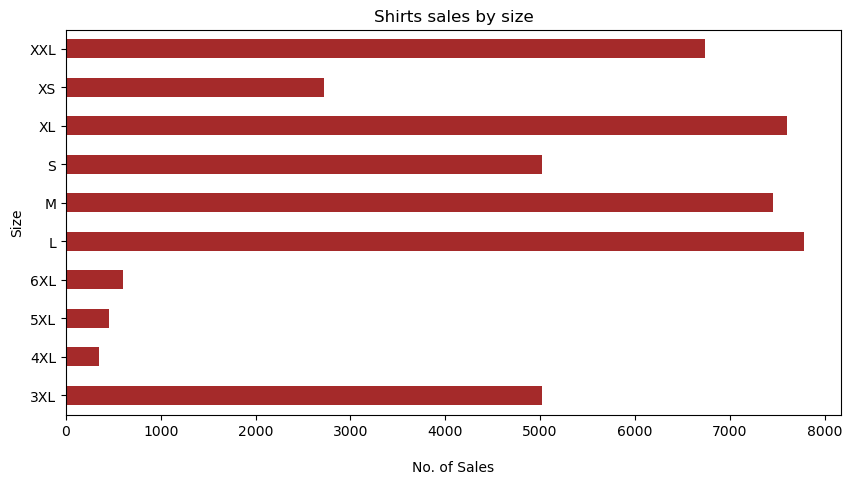

In [48]:
ax = filtered_result.loc['Shirt',:].plot(kind='barh', title='Shirts sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', figsize=(10,5))
print(ax.patches[0])

Rectangle(xy=(0, -0.25), width=1730, height=0.5, angle=0)


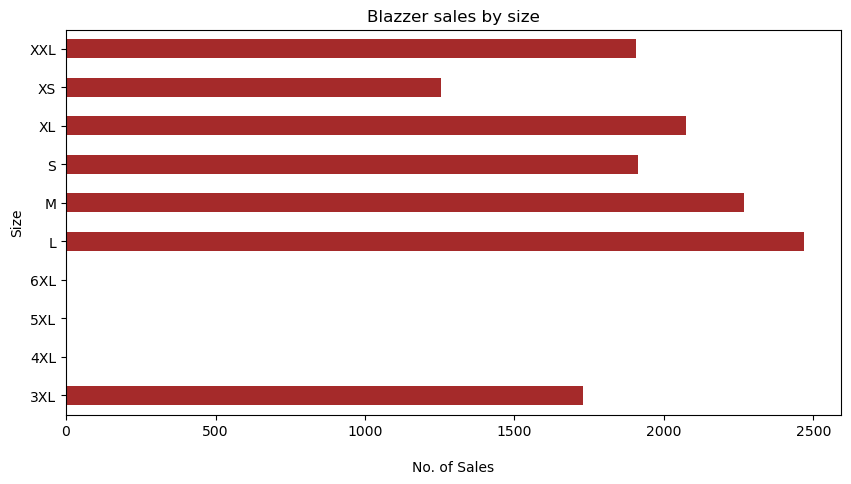

In [49]:
ax = filtered_result.loc['Blazzer',:].plot(kind='barh', title='Blazzer sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', figsize=(10,5))
print(ax.patches[0])

Rectangle(xy=(0, -0.25), width=1098, height=0.5, angle=0)


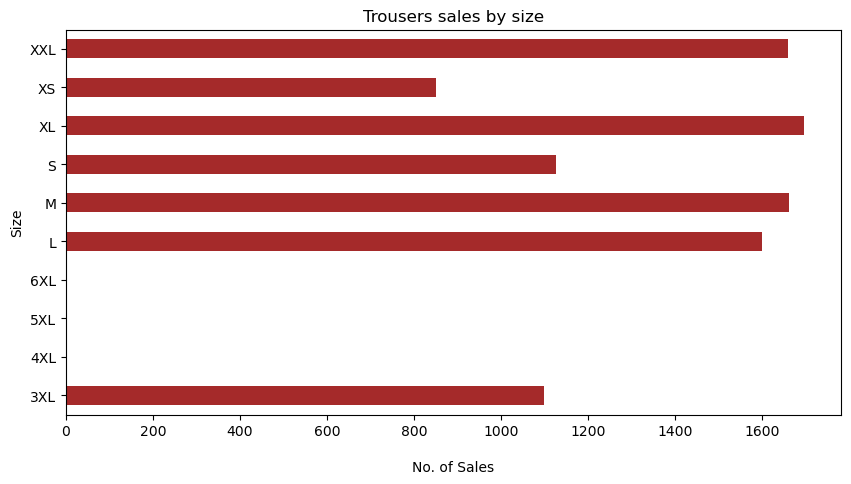

In [50]:
ax = filtered_result.loc['Trousers',:].plot(kind='barh', title='Trousers sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', figsize=(10,5))
print(ax.patches[0])

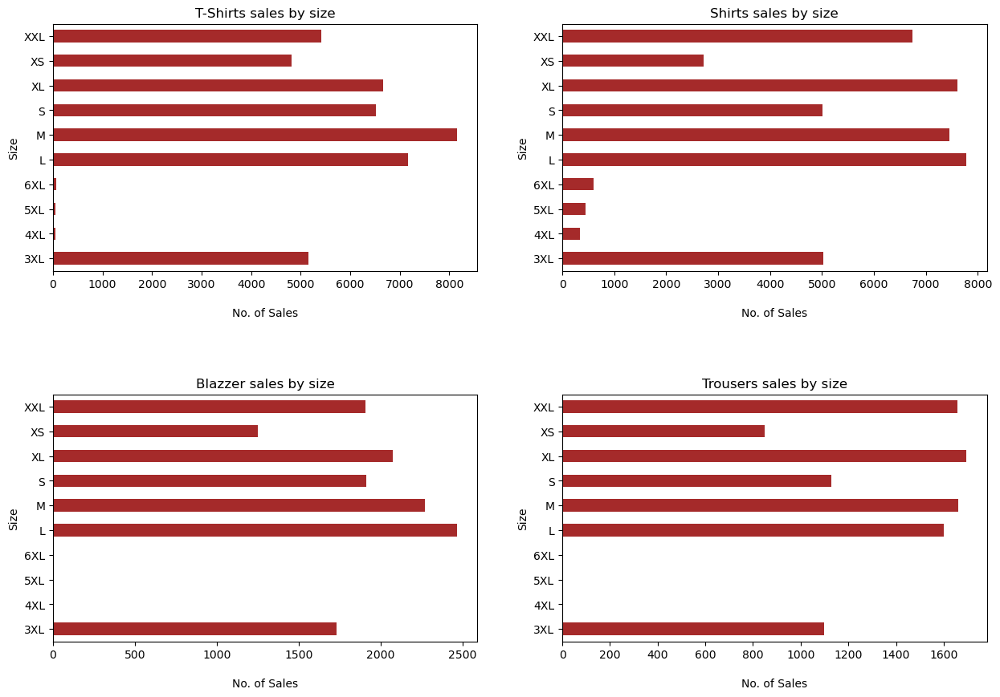

In [51]:
fig,ax = plt.subplots(2,2, figsize=(15,10))
plt.subplots_adjust(wspace=0.2, hspace=0.5)
filtered_result.loc['T-shirt',:].plot(kind='barh', title='T-Shirts sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', ax=ax[0,0])
filtered_result.loc['Shirt',:].plot(kind='barh', title='Shirts sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', ax=ax[0,1])
filtered_result.loc['Blazzer',:].plot(kind='barh', title='\n\nBlazzer sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', ax=ax[1,0])
filtered_result.loc['Trousers',:].plot(kind='barh', title='\n\nTrousers sales by size', ylabel='Size', color='brown',\
    xlabel='\nNo. of Sales', ax=ax[1,1])
plt.show()

In [52]:
sortedByDate.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,404-5350794-8541144,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,L,Shipped,1,INR,481.00,KOLKATA,WEST BENGAL,700124.0,IN,False,unknown
1,171-3572716-7638764,2022-03-31,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,XXL,Shipped,1,INR,248.00,NADUVANNUR,KERALA,673614.0,IN,False,Easy Ship
2,402-7244631-8305928,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,Shirt,XXL,Shipped,1,INR,322.00,CHENNAI,TAMIL NADU,600042.0,IN,False,unknown
3,406-7387241-2881923,2022-03-31,Shipped,Amazon,Amazon.in,Expedited,T-shirt,XL,Shipped,1,INR,599.00,BENGALURU,KARNATAKA,560090.0,IN,False,unknown
4,402-9332104-0945115,2022-03-31,Cancelled,Merchant,Amazon.in,Standard,Shirt,M,On the Way,0,INR,416.19,GURGAON,HARYANA,122001.0,IN,False,Easy Ship


In [53]:
file.head()

,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Category,Size,Courier Status,Qty,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,B2B,fulfilled-by
0,405-8078784-5731545,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,T-shirt,S,On the Way,0,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,False,Easy Ship
1,171-9198151-1101146,2022-04-30,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,Shirt,3XL,Shipped,1,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,False,Easy Ship
2,404-0687676-7273146,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Shirt,XL,Shipped,1,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,True,unknown
3,403-9615377-8133951,2022-04-30,Cancelled,Merchant,Amazon.in,Standard,Blazzer,L,On the Way,0,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,False,Easy Ship
4,407-1069790-7240320,2022-04-30,Shipped,Amazon,Amazon.in,Expedited,Trousers,3XL,Shipped,1,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,False,unknown


In [54]:
sortedByDate['ship-state'].value_counts()

MAHARASHTRA      20523
KARNATAKA        15948
TAMIL NADU       10554
TELANGANA        10411
UTTAR PRADESH     9677
                 ...  
AR                   1
Rajsthan             1
orissa               1
rajsthan             1
Mizoram              1
Name: ship-state, Length: 69, dtype: int64

In [55]:
sortedByDate['ship-state'].value_counts().sort_values(ascending=False)['unknown']

30

In [56]:
abc = sortedByDate['ship-state'].value_counts().sort_values(ascending=False)[0:15]

In [57]:
p=[]

for i in abc.index:
    p.append((str)(i).upper())
abc.index = p
abc

MAHARASHTRA       20523
KARNATAKA         15948
TAMIL NADU        10554
TELANGANA         10411
UTTAR PRADESH      9677
DELHI              6189
KERALA             6019
WEST BENGAL        5400
ANDHRA PRADESH     4955
HARYANA            4073
GUJARAT            4050
RAJASTHAN          2399
MADHYA PRADESH     2309
ODISHA             1932
BIHAR              1885
Name: ship-state, dtype: int64

In [58]:
geo_locations = {
    "Maharashtra": (19.3010, 74.7421),
    "Karnataka": (15.3173, 75.7139),
    "Tamil Nadu": (11.1271, 78.6569),
    "Telangana": (17.1734, 78.6569),
    "Uttar Pradesh": (27.5590, 80.1208),
    "Delhi": (28.6139, 77.2090),
    "Kerala": (10.8505, 76.2711),
    "West Bengal": (22.9868, 87.8550),
    "Andhra Pradesh": (15.9129, 79.7400),
    "Haryana": (29.0588, 76.0856),
    "Gujarat": (22.2587, 71.1924),
    "Rajasthan": (27.0238, 74.2176),
    "Madhya Pradesh": (23.4734, 77.9470),
    "Odisha": (20.9517, 85.0985),
    "Bihar": (25.0961, 85.3131),
    "Punjab": (30.7333, 76.7802),
    "Assam": (26.2006, 92.9376),
    "Uttarakhand": (30.0668, 79.0193),
    "Jharkhand": (23.6102, 85.2799),
    "Goa": (15.2993, 74.1240),
    "Chhattisgarh": (21.2787, 81.8661),
    "Himachal Pradesh": (31.1048, 77.1734),
    "Jammu & Kashmir": (33.7782, 76.5762),
    "Puducherry": (11.9416, 79.8083),
    "Chandigarh": (30.7333, 76.7794),
    "Manipur": (24.6637, 93.9063),
    "Andaman & Nicobar Islands": (11.6233, 92.7265),
    "Meghalaya": (25.4670, 91.3662),
    "Sikkim": (27.5330, 88.6139),
    "Nagaland": (26.1584, 94.5624),
    "Tripura": (23.8340, 91.2867),
    "Arunachal Pradesh": (28.2180, 94.7278),
    "Mizoram": (23.1645, 92.9376),
    "Dadra and Nagar Haveli": (20.2661, 73.7398),
    "Ladakh": (34.1526, 77.5788),
    "Lakshadweep": (10.5722, 72.6417),
}

In [59]:
geo_locations = {k.upper(): v for k, v in geo_locations.items()}    # create a dictionary with uppercase keys
geo_locations

{'MAHARASHTRA': (19.301, 74.7421),
 'KARNATAKA': (15.3173, 75.7139),
 'TAMIL NADU': (11.1271, 78.6569),
 'TELANGANA': (17.1734, 78.6569),
 'UTTAR PRADESH': (27.559, 80.1208),
 'DELHI': (28.6139, 77.209),
 'KERALA': (10.8505, 76.2711),
 'WEST BENGAL': (22.9868, 87.855),
 'ANDHRA PRADESH': (15.9129, 79.74),
 'HARYANA': (29.0588, 76.0856),
 'GUJARAT': (22.2587, 71.1924),
 'RAJASTHAN': (27.0238, 74.2176),
 'MADHYA PRADESH': (23.4734, 77.947),
 'ODISHA': (20.9517, 85.0985),
 'BIHAR': (25.0961, 85.3131),
 'PUNJAB': (30.7333, 76.7802),
 'ASSAM': (26.2006, 92.9376),
 'UTTARAKHAND': (30.0668, 79.0193),
 'JHARKHAND': (23.6102, 85.2799),
 'GOA': (15.2993, 74.124),
 'CHHATTISGARH': (21.2787, 81.8661),
 'HIMACHAL PRADESH': (31.1048, 77.1734),
 'JAMMU & KASHMIR': (33.7782, 76.5762),
 'PUDUCHERRY': (11.9416, 79.8083),
 'CHANDIGARH': (30.7333, 76.7794),
 'MANIPUR': (24.6637, 93.9063),
 'ANDAMAN & NICOBAR ISLANDS': (11.6233, 92.7265),
 'MEGHALAYA': (25.467, 91.3662),
 'SIKKIM': (27.533, 88.6139),
 'NAG

Sales on qty wise by state of top 10 states

In [60]:
state_sales_byQTY = sortedByDate.groupby('ship-state')['Qty'].sum().sort_values(ascending=False)[0:10].to_frame()

In [61]:
state_sales_byQTY

,Qty
ship-state,
MAHARASHTRA,19781
KARNATAKA,15463
TAMIL NADU,10164
TELANGANA,10029
UTTAR PRADESH,9230
DELHI,5952
KERALA,5684
WEST BENGAL,5172
ANDHRA PRADESH,4719


In [62]:
state_sales_byQTY['Latitude'] = state_sales_byQTY.index.map(lambda x: geo_locations[x][0])
state_sales_byQTY['Longitude'] = state_sales_byQTY.index.map(lambda x: geo_locations[x][1])
state_sales_byQTY

,Qty,Latitude,Longitude
ship-state,,,
MAHARASHTRA,19781,19.3010,74.7421
KARNATAKA,15463,15.3173,75.7139
TAMIL NADU,10164,11.1271,78.6569
TELANGANA,10029,17.1734,78.6569
UTTAR PRADESH,9230,27.5590,80.1208
DELHI,5952,28.6139,77.2090
KERALA,5684,10.8505,76.2711
WEST BENGAL,5172,22.9868,87.8550
ANDHRA PRADESH,4719,15.9129,79.7400


In [63]:
state_saleByAmount = sortedByDate.groupby('ship-state')['Amount'].sum().sort_values(ascending=False)[0:10].to_frame()
state_saleByAmount['Latitude'] = state_saleByAmount.index.map(lambda x: geo_locations[x][0])
state_saleByAmount['Longitude'] = state_saleByAmount.index.map(lambda x: geo_locations[x][1])
state_saleByAmount

,Amount,Latitude,Longitude
ship-state,,,
MAHARASHTRA,13261933.90,19.3010,74.7421
KARNATAKA,10421496.02,15.3173,75.7139
TELANGANA,6880035.27,17.1734,78.6569
UTTAR PRADESH,6798644.08,27.5590,80.1208
TAMIL NADU,6477109.53,11.1271,78.6569
DELHI,4216456.97,28.6139,77.2090
KERALA,3798362.96,10.8505,76.2711
WEST BENGAL,3487951.01,22.9868,87.8550
ANDHRA PRADESH,3198443.86,15.9129,79.7400


In [64]:
# import folium

# Create a map centered around India

# india_map = folium.Map(location=[20.5937, 78.9629], zoom_start=5)
# # Add markers for each state
# for state, row in state_sales.iterrows():
#     folium.Marker(
#         location=[row['Latitude'], row['Longitude']],
#         popup=f"{state}: {row['Qty']} sales",
#         icon=folium.Icon(color='blue', icon='info-sign')
#     ).add_to(india_map)

# # Display the map
# india_map

In [65]:
import folium
import requests

# URL to the GeoJSON data for Indian states
geojson_url = 'https://raw.githubusercontent.com/geohacker/india/master/state/india_telengana.geojson'

# Fetch the GeoJSON data
geojson_data = requests.get(geojson_url).json()

# # Add the GeoJSON data to the map
# folium.GeoJson(
#     geojson_data,
#     name='geojson'
# ).add_to(india_map)

# # Add layer control to toggle the GeoJSON layer
# folium.LayerControl().add_to(india_map)

# # Display the map
# india_map

In [66]:
import json
import os
jfile = json.dumps(geojson_data, indent=4)


In [67]:
desktop_path = os.path.expanduser("~/Desktop/state_population.json")    # abreviated path like tilde(~) is not supported directly in open(), this is a solution to that.

# Save the JSON string to a file on the desktop
with open(desktop_path, 'w') as f:
    f.write(jfile)

print(f"JSON file saved to: {desktop_path}")

JSON file saved to: /Users/irsathazeez/Desktop/state_population.json


In [68]:
geojson_data['features'][2]['properties']['NAME_1']

'Andhra Pradesh'

In [69]:
# geojson_data

In [70]:
# state_saleByAmount
# geojson_data['features'][2]['properties']

In [71]:
state_saleByAmount.index

Index(['MAHARASHTRA', 'KARNATAKA', 'TELANGANA', 'UTTAR PRADESH', 'TAMIL NADU',
       'DELHI', 'KERALA', 'WEST BENGAL', 'ANDHRA PRADESH', 'HARYANA'],
      dtype='object', name='ship-state')

In [72]:
filtered_states = {
    "type": "FeatureCollection",
    "features": [
        feature for feature in geojson_data["features"]
        if feature["properties"]["NAME_1"].upper() in state_saleByAmount.index
    ]
}


In [73]:
for val in filtered_states['features']:
    print(val['properties']['NAME_1'])

Telangana
Andhra Pradesh
Delhi
Haryana
Karnataka
Kerala
Maharashtra
Tamil Nadu
Uttar Pradesh
West Bengal


In [74]:
state_saleByAmount.index


Index(['MAHARASHTRA', 'KARNATAKA', 'TELANGANA', 'UTTAR PRADESH', 'TAMIL NADU',
       'DELHI', 'KERALA', 'WEST BENGAL', 'ANDHRA PRADESH', 'HARYANA'],
      dtype='object', name='ship-state')

In [75]:
max_sale = state_saleByAmount['Amount'].max()
max_Qty = state_sales_byQTY['Qty'].max()

In [76]:
def get_color(state):
    # Normalize the population value between 0 and 1
    max_state_norm = state / max_sale
    # Return a color based on normalized population (shades of blue)
    return f'rgba(0, 0, {int(255 * max_state_norm)}, 0.6)'  # Blue gradient

def get_color1(state):
    # Normalize the population value between 0 and 1
    max_state_norm = state / max_Qty
    # Return a color based on normalized population (shades of blue)
    return f'rgba({int(255 * max_state_norm)}, 0, 0, 0.6)'  # Blue gradient

# Define a function to style the states based on population
def highlight_states1(feature):
    state_name = feature['properties']['NAME_1']
    state = state_saleByAmount.loc[state_name.upper(), 'Amount']
    fill_color = get_color(state)  # Get color based on population

    return {
        'fillColor': fill_color,
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.6,
    }
def highlight_states2(feature):
    state_name = feature['properties']['NAME_1']
    state = state_sales_byQTY.loc[state_name.upper(), 'Qty']
    fill_color = get_color1(state)  # Get color based on population

    return {
        'fillColor': fill_color,
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.6,
    }

In [77]:
# state_saleByAmount

In [78]:
india_map2 = folium.Map(location=[20.5937, 78.9629], zoom_start=5)
folium.GeoJson(
    filtered_states,
    name='Selected States_Amount',
    style_function=highlight_states1,
).add_to(india_map2)
folium.GeoJson(
    filtered_states,
    name='Selected States_QTY',
    style_function=highlight_states2,
).add_to(india_map2)

# Add layer control to toggle the GeoJSON layer
folium.LayerControl().add_to(india_map2)
india_map2
# 'MAHARASHTRA', 'KARNATAKA', 'TELANGANA', 'UTTAR PRADESH', 'TAMIL NADU',
    #    'DELHI', 'KERALA', 'WEST BENGAL', 'ANDHRA PRADESH', 'HARYANA'

In [79]:
state_saleByAmount

,Amount,Latitude,Longitude
ship-state,,,
MAHARASHTRA,13261933.90,19.3010,74.7421
KARNATAKA,10421496.02,15.3173,75.7139
TELANGANA,6880035.27,17.1734,78.6569
UTTAR PRADESH,6798644.08,27.5590,80.1208
TAMIL NADU,6477109.53,11.1271,78.6569
DELHI,4216456.97,28.6139,77.2090
KERALA,3798362.96,10.8505,76.2711
WEST BENGAL,3487951.01,22.9868,87.8550
ANDHRA PRADESH,3198443.86,15.9129,79.7400


In [80]:
state_sales_byQTY

,Qty,Latitude,Longitude
ship-state,,,
MAHARASHTRA,19781,19.3010,74.7421
KARNATAKA,15463,15.3173,75.7139
TAMIL NADU,10164,11.1271,78.6569
TELANGANA,10029,17.1734,78.6569
UTTAR PRADESH,9230,27.5590,80.1208
DELHI,5952,28.6139,77.2090
KERALA,5684,10.8505,76.2711
WEST BENGAL,5172,22.9868,87.8550
ANDHRA PRADESH,4719,15.9129,79.7400
